In [13]:
import pandas as pd
import io
import requests
import matplotlib.pyplot as plt
import numpy as np
from datetime import datetime, timedelta
import plotly.graph_objects as go
import plotly.express as px
from scipy.fft import fft

### Importing the database into pandas

Import like so:

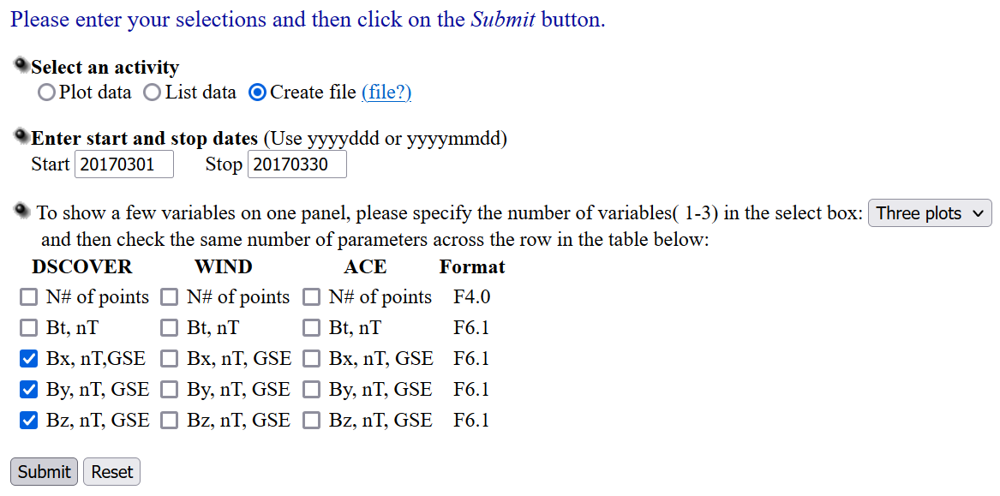

In [14]:
# Filepath to downloaded data
file_path = "data/ACE/readings_ACE.lst"

In [15]:
columns = ["Year", "Day", "Hour", "Bx_gse, nT", "By_gse, nT" , "Bz_gse, nT"]

df = pd.read_csv(file_path, sep = "\s+", header=None, names= columns)

#Combine Year, day, and hour
def CombinedDate(year, day_number, hour):
    date_format = '%Y-%m-%d %H:%M:%S'
    start_date = datetime(year, 1, 1, 0, 0, 0)                                # create a datetime object for January 1st midnight of the given year
    result_date = start_date + timedelta(days=day_number-1, hours=hour) # add the number of days and hours to the start date
    return result_date.strftime(date_format)                            # format the date string using the specified format and retur it

date = []

for index in df.index:
    date.append(CombinedDate(int(df['Year'][index]), int(df['Day'][index]), int(df['Hour'][index])))

df.insert(0, "Date", date, True)    #inserting dates

# Remove all 999.99, replace with NaN
df['Bx_gse, nT'].replace(999.9, None, inplace=True)
df['By_gse, nT'].replace(999.9, None, inplace=True)
df['Bz_gse, nT'].replace(999.9, None, inplace=True)

df.head()

,Date,Year,Day,Hour,"Bx_gse, nT","By_gse, nT","Bz_gse, nT"
0,1998-02-05 00:00:00,1998,36,0,None,None,None
1,1998-02-05 01:00:00,1998,36,1,13.4,0.1,3.1
2,1998-02-05 02:00:00,1998,36,2,13.2,0.1,3.5
3,1998-02-05 03:00:00,1998,36,3,12.3,-1.6,4.7
4,1998-02-05 04:00:00,1998,36,4,11.8,-0.8,5.6


### Plotting the raw data

In [16]:
# Create figure
fig_raw = go.Figure()

# Plotting the data
fig_raw.add_trace(
    go.Scatter(x=list(df['Date']), y=list(df['Bx_gse, nT']), name='Bx (GSM)'))
fig_raw.add_trace(
    go.Scatter(x=list(df['Date']), y=list(df['By_gse, nT']), name='By (GSM)'))
fig_raw.add_trace(
    go.Scatter(x=list(df['Date']), y=list(df['Bz_gse, nT']), name='Bz (GSM)'))


# Updating layout
fig_raw.update_layout(
    title="Strength of interplanetary magnetic field (IMF) components",
    xaxis_title="Date",
    yaxis_title="IMF Strength [nT]",
    legend_title="Component",
)


# Add range slider
fig_raw.update_layout(
    xaxis=dict(
        rangeselector=dict(
            buttons=list([
                dict(count=7,
                     label="1 week",
                     step="day",
                     stepmode="backward"),
                dict(count=1,
                     label="1 month",
                     step="month",
                     stepmode="backward"),
                dict(count=3,
                     label="3 months",
                     step="month",
                     stepmode="backward"),
                dict(count=1,
                     label="1 year",
                     step="year",
                     stepmode="backward"),
                dict(step="all")
            ])
        ),
        rangeslider=dict(
            visible=True
        ),
        type="date"
    )
)

fig_raw.show()

### Spectral Analysis of Bz component

The ACE, Wind, and DSCOVR spacecraft are are at the L1 lagrangian point and when the z-component of the measured magentic field becomes negative (southward) at this point, it indicates that solar winds have pushed back Earth's magnetic field (MF) - refer to the image below. The more Earth's MF is pushed back, the lower the detected value. This can serve as a warning that solar wind particles and energy may gain access into the geospace environment and potentially cause disruptions and other space weather effects like the auroras. Spectral analysis of the negative portion of the Bz component allows us to visualize the frequency (how often they occur) and strength (how far back they push Earth's MF) of these solar winds.

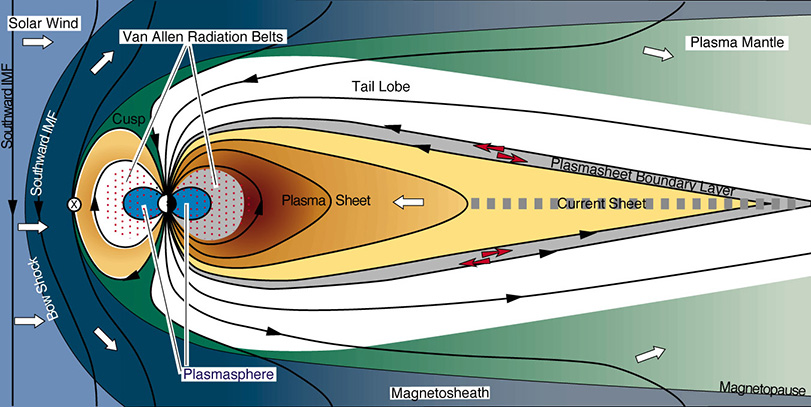

This image was take from SpaceWeatherLive.com (https://www.spaceweatherlive.com/en/help/the-interplanetary-magnetic-field-imf.html) on 8/Oct/2023


In [20]:
Bz_neg = df['Bz_gse, nT']
dates_Bz_neg = df['Date']

#Computing the Fourrier trasnform for specral analysis
spectral = list(fft(Bz_neg))

In [25]:
df['Bz_gse, nT'].fillna(0, inplace=True)
fft_vals = np.fft.fft(df["Bz_gse, nT"])

fft_freq = np.fft.fftfreq(len(fft_vals))# Corresponding frequencies

# Create figure
fig_spectral = go.Figure()

# Plotting the data
fig_spectral.add_trace(
    go.Scatter(x=list(np.abs(fft_freq)), y=list(np.abs(fft_vals))))


# Updating layout
fig_spectral.update_layout(
    title="Spectral Analysis of Bz",
    xaxis_title="Frequency of Occurance",
    yaxis_title="Magnitude"
)

fig_spectral.show()
